# Iranian Customer Churn Classifier

https://archive.ics.uci.edu/dataset/563/iranian+churn+dataset

In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns

from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score, confusion_matrix, precision_score, recall_score, f1_score, log_loss, auc, roc_auc_score

from supervised import AutoML

import os

Using `tqdm.autonotebook.tqdm` in notebook mode. Use `tqdm.tqdm` instead to force console mode (e.g. in jupyter console)


### Get Dataset

In [2]:
data = pd.read_csv("../../data/Iranian-customer-churn.csv")
print(data.shape)

(3150, 14)


In [3]:
#find nas or null
print(data.isna().values.sum())
data[['Complains', 'Age Group', 'Tariff Plan', 'Status']] = data[['Complains', 'Age Group', 'Tariff Plan', 'Status']].astype("category")
data.info()

0
<class 'pandas.core.frame.DataFrame'>
RangeIndex: 3150 entries, 0 to 3149
Data columns (total 14 columns):
 #   Column                   Non-Null Count  Dtype   
---  ------                   --------------  -----   
 0   Call  Failure            3150 non-null   int64   
 1   Complains                3150 non-null   category
 2   Subscription  Length     3150 non-null   int64   
 3   Charge  Amount           3150 non-null   int64   
 4   Seconds of Use           3150 non-null   int64   
 5   Frequency of use         3150 non-null   int64   
 6   Frequency of SMS         3150 non-null   int64   
 7   Distinct Called Numbers  3150 non-null   int64   
 8   Age Group                3150 non-null   category
 9   Tariff Plan              3150 non-null   category
 10  Status                   3150 non-null   category
 11  Age                      3150 non-null   int64   
 12  Customer Value           3150 non-null   float64 
 13  Churn                    3150 non-null   int64   
dtypes: cat

In [4]:
data.head()

,Call Failure,Complains,Subscription Length,Charge Amount,Seconds of Use,Frequency of use,Frequency of SMS,Distinct Called Numbers,Age Group,Tariff Plan,Status,Age,Customer Value,Churn
0,8,0,38,0,4370,71,5,17,3,1,1,30,197.640,0
1,0,0,39,0,318,5,7,4,2,1,2,25,46.035,0
2,10,0,37,0,2453,60,359,24,3,1,1,30,1536.520,0
3,10,0,38,0,4198,66,1,35,1,1,1,15,240.020,0
4,3,0,38,0,2393,58,2,33,1,1,1,15,145.805,0


In [5]:
label = 'Churn'
data[label].value_counts()

Churn
0    2655
1     495
Name: count, dtype: int64

### Split train/test set

In [6]:
train_df, test_df = train_test_split(data, test_size=0.2, stratify=data[label], shuffle=True, random_state=32)

print(train_df.shape)
print(test_df.shape)

(2520, 14)
(630, 14)


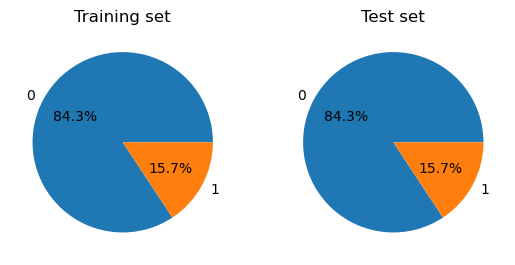

In [7]:
training_label_dist = train_df[label].value_counts()
test_label_dist = test_df[label].value_counts()

fig, ax = plt.subplots(ncols=2)
ax[0].pie(training_label_dist, labels=training_label_dist.index, autopct='%1.1f%%')
ax[0].set_title('Training set')
ax[1].pie(test_label_dist, labels=test_label_dist.index, autopct='%1.1f%%')
ax[1].set_title('Test set')
plt.show()

### Data analysis

Done using AutoViz

### Training

In [8]:
def display_metrics(y_true, y_pred):
    print("Accuracy score:", round(accuracy_score(y_true, y_pred),4))
    print("Precision score:", round(precision_score(y_true, y_pred, average='macro'),4))
    print("Recall score:", round(recall_score(y_true, y_pred, average='macro'),4))
    print("F1 score:", round(f1_score(y_true, y_pred, average='macro'),4))
    # print("AUC score:", round(auc(y_true, y_pred),4))
    print("ROC auc score:", round(roc_auc_score(y_true, y_pred),4))
    print("Log loss:", round(log_loss(y_true, y_pred),4))
    print("\n\n")
    cm = confusion_matrix(y_true, y_pred)
    ncm = cm.astype('float') / cm.sum(axis=1)[:, np.newaxis]

    fig, ax = plt.subplots(ncols=2, figsize=(15, 6))
    sns.heatmap(cm, annot=True, fmt='', ax=ax[0])
    ax[0].set_ylabel('Actual')
    ax[0].set_xlabel('Predicted')
    ax[0].set_title('Confusion Matrix')

    sns.heatmap(ncm, annot=True, fmt='.2f', ax=ax[1])
    ax[1].set_ylabel('Actual')
    ax[1].set_xlabel('Predicted')
    ax[1].set_title('Normalized Confusion Matrix')


In [9]:
# train_data.ID.value_counts() shows that ID is an identity field. So we will remove such
X_train = train_df.drop(columns=[label])
y_train = train_df[label]

automl = AutoML(mode="Perform", 
                ml_task='binary_classification',
                results_path="iranian-customer-churn-classification", 
                eval_metric='f1', 
                explain_level = 1,
                total_time_limit=3*3600)
automl.fit(X_train, y_train)

AutoML directory: iranian-customer-churn-classification
The task is binary_classification with evaluation metric f1
AutoML will use algorithms: ['Linear', 'Random Forest', 'LightGBM', 'Xgboost', 'CatBoost', 'Neural Network']
AutoML will ensemble available models
AutoML steps: ['simple_algorithms', 'default_algorithms', 'not_so_random', 'golden_features', 'insert_random_feature', 'features_selection', 'hill_climbing_1', 'hill_climbing_2', 'ensemble']
* Step simple_algorithms will try to check up to 1 model
LinearAlgorithm should either be a classifier to be used with response_method=predict_proba or the response_method should be 'predict'. Got a regressor with response_method=predict_proba instead.
Problem during computing permutation importance. Skipping ...
LinearAlgorithm should either be a classifier to be used with response_method=predict_proba or the response_method should be 'predict'. Got a regressor with response_method=predict_proba instead.
Problem during computing permutatio

/Users/menudi/anaconda3/envs/mljar_env/lib/python3.10/site-packages/xgboost/training.py:39: UserWarning: `feval` is deprecated, use `custom_metric` instead.  They have different behavior when custom objective is also used.See https://xgboost.readthedocs.io/en/latest/tutorials/custom_metric_obj.html for details on the `custom_metric`.


XgbAlgorithm should either be a classifier to be used with response_method=predict_proba or the response_method should be 'predict'. Got a regressor with response_method=predict_proba instead.
Problem during computing permutation importance. Skipping ...


/Users/menudi/anaconda3/envs/mljar_env/lib/python3.10/site-packages/xgboost/training.py:39: UserWarning: `feval` is deprecated, use `custom_metric` instead.  They have different behavior when custom objective is also used.See https://xgboost.readthedocs.io/en/latest/tutorials/custom_metric_obj.html for details on the `custom_metric`.


XgbAlgorithm should either be a classifier to be used with response_method=predict_proba or the response_method should be 'predict'. Got a regressor with response_method=predict_proba instead.
Problem during computing permutation importance. Skipping ...


/Users/menudi/anaconda3/envs/mljar_env/lib/python3.10/site-packages/xgboost/training.py:39: UserWarning: `feval` is deprecated, use `custom_metric` instead.  They have different behavior when custom objective is also used.See https://xgboost.readthedocs.io/en/latest/tutorials/custom_metric_obj.html for details on the `custom_metric`.


XgbAlgorithm should either be a classifier to be used with response_method=predict_proba or the response_method should be 'predict'. Got a regressor with response_method=predict_proba instead.
Problem during computing permutation importance. Skipping ...


/Users/menudi/anaconda3/envs/mljar_env/lib/python3.10/site-packages/xgboost/training.py:39: UserWarning: `feval` is deprecated, use `custom_metric` instead.  They have different behavior when custom objective is also used.See https://xgboost.readthedocs.io/en/latest/tutorials/custom_metric_obj.html for details on the `custom_metric`.


XgbAlgorithm should either be a classifier to be used with response_method=predict_proba or the response_method should be 'predict'. Got a regressor with response_method=predict_proba instead.
Problem during computing permutation importance. Skipping ...


/Users/menudi/anaconda3/envs/mljar_env/lib/python3.10/site-packages/xgboost/training.py:39: UserWarning: `feval` is deprecated, use `custom_metric` instead.  They have different behavior when custom objective is also used.See https://xgboost.readthedocs.io/en/latest/tutorials/custom_metric_obj.html for details on the `custom_metric`.


XgbAlgorithm should either be a classifier to be used with response_method=predict_proba or the response_method should be 'predict'. Got a regressor with response_method=predict_proba instead.
Problem during computing permutation importance. Skipping ...
3_Default_Xgboost f1 0.863049 trained in 4.38 seconds (1-sample predict time 0.0266 seconds)
CatBoostAlgorithm should either be a classifier to be used with response_method=predict_proba or the response_method should be 'predict'. Got a regressor with response_method=predict_proba instead.
Problem during computing permutation importance. Skipping ...
CatBoostAlgorithm should either be a classifier to be used with response_method=predict_proba or the response_method should be 'predict'. Got a regressor with response_method=predict_proba instead.
Problem during computing permutation importance. Skipping ...
CatBoostAlgorithm should either be a classifier to be used with response_method=predict_proba or the response_method should be 'pred

/Users/menudi/anaconda3/envs/mljar_env/lib/python3.10/site-packages/xgboost/training.py:39: UserWarning: `feval` is deprecated, use `custom_metric` instead.  They have different behavior when custom objective is also used.See https://xgboost.readthedocs.io/en/latest/tutorials/custom_metric_obj.html for details on the `custom_metric`.


XgbAlgorithm should either be a classifier to be used with response_method=predict_proba or the response_method should be 'predict'. Got a regressor with response_method=predict_proba instead.
Problem during computing permutation importance. Skipping ...


/Users/menudi/anaconda3/envs/mljar_env/lib/python3.10/site-packages/xgboost/training.py:39: UserWarning: `feval` is deprecated, use `custom_metric` instead.  They have different behavior when custom objective is also used.See https://xgboost.readthedocs.io/en/latest/tutorials/custom_metric_obj.html for details on the `custom_metric`.


XgbAlgorithm should either be a classifier to be used with response_method=predict_proba or the response_method should be 'predict'. Got a regressor with response_method=predict_proba instead.
Problem during computing permutation importance. Skipping ...


/Users/menudi/anaconda3/envs/mljar_env/lib/python3.10/site-packages/xgboost/training.py:39: UserWarning: `feval` is deprecated, use `custom_metric` instead.  They have different behavior when custom objective is also used.See https://xgboost.readthedocs.io/en/latest/tutorials/custom_metric_obj.html for details on the `custom_metric`.


XgbAlgorithm should either be a classifier to be used with response_method=predict_proba or the response_method should be 'predict'. Got a regressor with response_method=predict_proba instead.
Problem during computing permutation importance. Skipping ...


/Users/menudi/anaconda3/envs/mljar_env/lib/python3.10/site-packages/xgboost/training.py:39: UserWarning: `feval` is deprecated, use `custom_metric` instead.  They have different behavior when custom objective is also used.See https://xgboost.readthedocs.io/en/latest/tutorials/custom_metric_obj.html for details on the `custom_metric`.


XgbAlgorithm should either be a classifier to be used with response_method=predict_proba or the response_method should be 'predict'. Got a regressor with response_method=predict_proba instead.
Problem during computing permutation importance. Skipping ...


/Users/menudi/anaconda3/envs/mljar_env/lib/python3.10/site-packages/xgboost/training.py:39: UserWarning: `feval` is deprecated, use `custom_metric` instead.  They have different behavior when custom objective is also used.See https://xgboost.readthedocs.io/en/latest/tutorials/custom_metric_obj.html for details on the `custom_metric`.


XgbAlgorithm should either be a classifier to be used with response_method=predict_proba or the response_method should be 'predict'. Got a regressor with response_method=predict_proba instead.
Problem during computing permutation importance. Skipping ...
7_Xgboost f1 0.847368 trained in 4.81 seconds (1-sample predict time 0.0248 seconds)
CatBoostAlgorithm should either be a classifier to be used with response_method=predict_proba or the response_method should be 'predict'. Got a regressor with response_method=predict_proba instead.
Problem during computing permutation importance. Skipping ...
CatBoostAlgorithm should either be a classifier to be used with response_method=predict_proba or the response_method should be 'predict'. Got a regressor with response_method=predict_proba instead.
Problem during computing permutation importance. Skipping ...
CatBoostAlgorithm should either be a classifier to be used with response_method=predict_proba or the response_method should be 'predict'. Go

/Users/menudi/anaconda3/envs/mljar_env/lib/python3.10/site-packages/xgboost/training.py:39: UserWarning: `feval` is deprecated, use `custom_metric` instead.  They have different behavior when custom objective is also used.See https://xgboost.readthedocs.io/en/latest/tutorials/custom_metric_obj.html for details on the `custom_metric`.


XgbAlgorithm should either be a classifier to be used with response_method=predict_proba or the response_method should be 'predict'. Got a regressor with response_method=predict_proba instead.
Problem during computing permutation importance. Skipping ...


/Users/menudi/anaconda3/envs/mljar_env/lib/python3.10/site-packages/xgboost/training.py:39: UserWarning: `feval` is deprecated, use `custom_metric` instead.  They have different behavior when custom objective is also used.See https://xgboost.readthedocs.io/en/latest/tutorials/custom_metric_obj.html for details on the `custom_metric`.


XgbAlgorithm should either be a classifier to be used with response_method=predict_proba or the response_method should be 'predict'. Got a regressor with response_method=predict_proba instead.
Problem during computing permutation importance. Skipping ...


/Users/menudi/anaconda3/envs/mljar_env/lib/python3.10/site-packages/xgboost/training.py:39: UserWarning: `feval` is deprecated, use `custom_metric` instead.  They have different behavior when custom objective is also used.See https://xgboost.readthedocs.io/en/latest/tutorials/custom_metric_obj.html for details on the `custom_metric`.


XgbAlgorithm should either be a classifier to be used with response_method=predict_proba or the response_method should be 'predict'. Got a regressor with response_method=predict_proba instead.
Problem during computing permutation importance. Skipping ...


/Users/menudi/anaconda3/envs/mljar_env/lib/python3.10/site-packages/xgboost/training.py:39: UserWarning: `feval` is deprecated, use `custom_metric` instead.  They have different behavior when custom objective is also used.See https://xgboost.readthedocs.io/en/latest/tutorials/custom_metric_obj.html for details on the `custom_metric`.


XgbAlgorithm should either be a classifier to be used with response_method=predict_proba or the response_method should be 'predict'. Got a regressor with response_method=predict_proba instead.
Problem during computing permutation importance. Skipping ...


/Users/menudi/anaconda3/envs/mljar_env/lib/python3.10/site-packages/xgboost/training.py:39: UserWarning: `feval` is deprecated, use `custom_metric` instead.  They have different behavior when custom objective is also used.See https://xgboost.readthedocs.io/en/latest/tutorials/custom_metric_obj.html for details on the `custom_metric`.


XgbAlgorithm should either be a classifier to be used with response_method=predict_proba or the response_method should be 'predict'. Got a regressor with response_method=predict_proba instead.
Problem during computing permutation importance. Skipping ...
8_Xgboost f1 0.855297 trained in 4.33 seconds (1-sample predict time 0.0252 seconds)
CatBoostAlgorithm should either be a classifier to be used with response_method=predict_proba or the response_method should be 'predict'. Got a regressor with response_method=predict_proba instead.
Problem during computing permutation importance. Skipping ...
CatBoostAlgorithm should either be a classifier to be used with response_method=predict_proba or the response_method should be 'predict'. Got a regressor with response_method=predict_proba instead.
Problem during computing permutation importance. Skipping ...
CatBoostAlgorithm should either be a classifier to be used with response_method=predict_proba or the response_method should be 'predict'. Go

/Users/menudi/anaconda3/envs/mljar_env/lib/python3.10/site-packages/xgboost/training.py:39: UserWarning: `feval` is deprecated, use `custom_metric` instead.  They have different behavior when custom objective is also used.See https://xgboost.readthedocs.io/en/latest/tutorials/custom_metric_obj.html for details on the `custom_metric`.


XgbAlgorithm should either be a classifier to be used with response_method=predict_proba or the response_method should be 'predict'. Got a regressor with response_method=predict_proba instead.
Problem during computing permutation importance. Skipping ...


/Users/menudi/anaconda3/envs/mljar_env/lib/python3.10/site-packages/xgboost/training.py:39: UserWarning: `feval` is deprecated, use `custom_metric` instead.  They have different behavior when custom objective is also used.See https://xgboost.readthedocs.io/en/latest/tutorials/custom_metric_obj.html for details on the `custom_metric`.


XgbAlgorithm should either be a classifier to be used with response_method=predict_proba or the response_method should be 'predict'. Got a regressor with response_method=predict_proba instead.
Problem during computing permutation importance. Skipping ...


/Users/menudi/anaconda3/envs/mljar_env/lib/python3.10/site-packages/xgboost/training.py:39: UserWarning: `feval` is deprecated, use `custom_metric` instead.  They have different behavior when custom objective is also used.See https://xgboost.readthedocs.io/en/latest/tutorials/custom_metric_obj.html for details on the `custom_metric`.


XgbAlgorithm should either be a classifier to be used with response_method=predict_proba or the response_method should be 'predict'. Got a regressor with response_method=predict_proba instead.
Problem during computing permutation importance. Skipping ...


/Users/menudi/anaconda3/envs/mljar_env/lib/python3.10/site-packages/xgboost/training.py:39: UserWarning: `feval` is deprecated, use `custom_metric` instead.  They have different behavior when custom objective is also used.See https://xgboost.readthedocs.io/en/latest/tutorials/custom_metric_obj.html for details on the `custom_metric`.


XgbAlgorithm should either be a classifier to be used with response_method=predict_proba or the response_method should be 'predict'. Got a regressor with response_method=predict_proba instead.
Problem during computing permutation importance. Skipping ...


/Users/menudi/anaconda3/envs/mljar_env/lib/python3.10/site-packages/xgboost/training.py:39: UserWarning: `feval` is deprecated, use `custom_metric` instead.  They have different behavior when custom objective is also used.See https://xgboost.readthedocs.io/en/latest/tutorials/custom_metric_obj.html for details on the `custom_metric`.


XgbAlgorithm should either be a classifier to be used with response_method=predict_proba or the response_method should be 'predict'. Got a regressor with response_method=predict_proba instead.
Problem during computing permutation importance. Skipping ...
9_Xgboost f1 0.697872 trained in 5.67 seconds (1-sample predict time 0.0236 seconds)
CatBoostAlgorithm should either be a classifier to be used with response_method=predict_proba or the response_method should be 'predict'. Got a regressor with response_method=predict_proba instead.
Problem during computing permutation importance. Skipping ...
CatBoostAlgorithm should either be a classifier to be used with response_method=predict_proba or the response_method should be 'predict'. Got a regressor with response_method=predict_proba instead.
Problem during computing permutation importance. Skipping ...
CatBoostAlgorithm should either be a classifier to be used with response_method=predict_proba or the response_method should be 'predict'. Go

/Users/menudi/anaconda3/envs/mljar_env/lib/python3.10/site-packages/xgboost/training.py:39: UserWarning: `feval` is deprecated, use `custom_metric` instead.  They have different behavior when custom objective is also used.See https://xgboost.readthedocs.io/en/latest/tutorials/custom_metric_obj.html for details on the `custom_metric`.


XgbAlgorithm should either be a classifier to be used with response_method=predict_proba or the response_method should be 'predict'. Got a regressor with response_method=predict_proba instead.
Problem during computing permutation importance. Skipping ...


/Users/menudi/anaconda3/envs/mljar_env/lib/python3.10/site-packages/xgboost/training.py:39: UserWarning: `feval` is deprecated, use `custom_metric` instead.  They have different behavior when custom objective is also used.See https://xgboost.readthedocs.io/en/latest/tutorials/custom_metric_obj.html for details on the `custom_metric`.


XgbAlgorithm should either be a classifier to be used with response_method=predict_proba or the response_method should be 'predict'. Got a regressor with response_method=predict_proba instead.
Problem during computing permutation importance. Skipping ...


/Users/menudi/anaconda3/envs/mljar_env/lib/python3.10/site-packages/xgboost/training.py:39: UserWarning: `feval` is deprecated, use `custom_metric` instead.  They have different behavior when custom objective is also used.See https://xgboost.readthedocs.io/en/latest/tutorials/custom_metric_obj.html for details on the `custom_metric`.


XgbAlgorithm should either be a classifier to be used with response_method=predict_proba or the response_method should be 'predict'. Got a regressor with response_method=predict_proba instead.
Problem during computing permutation importance. Skipping ...


/Users/menudi/anaconda3/envs/mljar_env/lib/python3.10/site-packages/xgboost/training.py:39: UserWarning: `feval` is deprecated, use `custom_metric` instead.  They have different behavior when custom objective is also used.See https://xgboost.readthedocs.io/en/latest/tutorials/custom_metric_obj.html for details on the `custom_metric`.


XgbAlgorithm should either be a classifier to be used with response_method=predict_proba or the response_method should be 'predict'. Got a regressor with response_method=predict_proba instead.
Problem during computing permutation importance. Skipping ...


/Users/menudi/anaconda3/envs/mljar_env/lib/python3.10/site-packages/xgboost/training.py:39: UserWarning: `feval` is deprecated, use `custom_metric` instead.  They have different behavior when custom objective is also used.See https://xgboost.readthedocs.io/en/latest/tutorials/custom_metric_obj.html for details on the `custom_metric`.


XgbAlgorithm should either be a classifier to be used with response_method=predict_proba or the response_method should be 'predict'. Got a regressor with response_method=predict_proba instead.
Problem during computing permutation importance. Skipping ...
10_Xgboost f1 0.204409 trained in 4.19 seconds (1-sample predict time 0.0231 seconds)
CatBoostAlgorithm should either be a classifier to be used with response_method=predict_proba or the response_method should be 'predict'. Got a regressor with response_method=predict_proba instead.
Problem during computing permutation importance. Skipping ...
CatBoostAlgorithm should either be a classifier to be used with response_method=predict_proba or the response_method should be 'predict'. Got a regressor with response_method=predict_proba instead.
Problem during computing permutation importance. Skipping ...
CatBoostAlgorithm should either be a classifier to be used with response_method=predict_proba or the response_method should be 'predict'. G

/Users/menudi/anaconda3/envs/mljar_env/lib/python3.10/site-packages/xgboost/training.py:39: UserWarning: `feval` is deprecated, use `custom_metric` instead.  They have different behavior when custom objective is also used.See https://xgboost.readthedocs.io/en/latest/tutorials/custom_metric_obj.html for details on the `custom_metric`.


XgbAlgorithm should either be a classifier to be used with response_method=predict_proba or the response_method should be 'predict'. Got a regressor with response_method=predict_proba instead.
Problem during computing permutation importance. Skipping ...


/Users/menudi/anaconda3/envs/mljar_env/lib/python3.10/site-packages/xgboost/training.py:39: UserWarning: `feval` is deprecated, use `custom_metric` instead.  They have different behavior when custom objective is also used.See https://xgboost.readthedocs.io/en/latest/tutorials/custom_metric_obj.html for details on the `custom_metric`.


XgbAlgorithm should either be a classifier to be used with response_method=predict_proba or the response_method should be 'predict'. Got a regressor with response_method=predict_proba instead.
Problem during computing permutation importance. Skipping ...


/Users/menudi/anaconda3/envs/mljar_env/lib/python3.10/site-packages/xgboost/training.py:39: UserWarning: `feval` is deprecated, use `custom_metric` instead.  They have different behavior when custom objective is also used.See https://xgboost.readthedocs.io/en/latest/tutorials/custom_metric_obj.html for details on the `custom_metric`.


XgbAlgorithm should either be a classifier to be used with response_method=predict_proba or the response_method should be 'predict'. Got a regressor with response_method=predict_proba instead.
Problem during computing permutation importance. Skipping ...


/Users/menudi/anaconda3/envs/mljar_env/lib/python3.10/site-packages/xgboost/training.py:39: UserWarning: `feval` is deprecated, use `custom_metric` instead.  They have different behavior when custom objective is also used.See https://xgboost.readthedocs.io/en/latest/tutorials/custom_metric_obj.html for details on the `custom_metric`.


XgbAlgorithm should either be a classifier to be used with response_method=predict_proba or the response_method should be 'predict'. Got a regressor with response_method=predict_proba instead.
Problem during computing permutation importance. Skipping ...


/Users/menudi/anaconda3/envs/mljar_env/lib/python3.10/site-packages/xgboost/training.py:39: UserWarning: `feval` is deprecated, use `custom_metric` instead.  They have different behavior when custom objective is also used.See https://xgboost.readthedocs.io/en/latest/tutorials/custom_metric_obj.html for details on the `custom_metric`.


XgbAlgorithm should either be a classifier to be used with response_method=predict_proba or the response_method should be 'predict'. Got a regressor with response_method=predict_proba instead.
Problem during computing permutation importance. Skipping ...
33_Xgboost f1 0.847458 trained in 6.65 seconds (1-sample predict time 0.0235 seconds)


/Users/menudi/anaconda3/envs/mljar_env/lib/python3.10/site-packages/xgboost/training.py:39: UserWarning: `feval` is deprecated, use `custom_metric` instead.  They have different behavior when custom objective is also used.See https://xgboost.readthedocs.io/en/latest/tutorials/custom_metric_obj.html for details on the `custom_metric`.


XgbAlgorithm should either be a classifier to be used with response_method=predict_proba or the response_method should be 'predict'. Got a regressor with response_method=predict_proba instead.
Problem during computing permutation importance. Skipping ...


/Users/menudi/anaconda3/envs/mljar_env/lib/python3.10/site-packages/xgboost/training.py:39: UserWarning: `feval` is deprecated, use `custom_metric` instead.  They have different behavior when custom objective is also used.See https://xgboost.readthedocs.io/en/latest/tutorials/custom_metric_obj.html for details on the `custom_metric`.


XgbAlgorithm should either be a classifier to be used with response_method=predict_proba or the response_method should be 'predict'. Got a regressor with response_method=predict_proba instead.
Problem during computing permutation importance. Skipping ...


/Users/menudi/anaconda3/envs/mljar_env/lib/python3.10/site-packages/xgboost/training.py:39: UserWarning: `feval` is deprecated, use `custom_metric` instead.  They have different behavior when custom objective is also used.See https://xgboost.readthedocs.io/en/latest/tutorials/custom_metric_obj.html for details on the `custom_metric`.


XgbAlgorithm should either be a classifier to be used with response_method=predict_proba or the response_method should be 'predict'. Got a regressor with response_method=predict_proba instead.
Problem during computing permutation importance. Skipping ...


/Users/menudi/anaconda3/envs/mljar_env/lib/python3.10/site-packages/xgboost/training.py:39: UserWarning: `feval` is deprecated, use `custom_metric` instead.  They have different behavior when custom objective is also used.See https://xgboost.readthedocs.io/en/latest/tutorials/custom_metric_obj.html for details on the `custom_metric`.


XgbAlgorithm should either be a classifier to be used with response_method=predict_proba or the response_method should be 'predict'. Got a regressor with response_method=predict_proba instead.
Problem during computing permutation importance. Skipping ...


/Users/menudi/anaconda3/envs/mljar_env/lib/python3.10/site-packages/xgboost/training.py:39: UserWarning: `feval` is deprecated, use `custom_metric` instead.  They have different behavior when custom objective is also used.See https://xgboost.readthedocs.io/en/latest/tutorials/custom_metric_obj.html for details on the `custom_metric`.


XgbAlgorithm should either be a classifier to be used with response_method=predict_proba or the response_method should be 'predict'. Got a regressor with response_method=predict_proba instead.
Problem during computing permutation importance. Skipping ...
34_Xgboost f1 0.846658 trained in 6.07 seconds (1-sample predict time 0.0242 seconds)
MLPAlgorithm should either be a classifier to be used with response_method=predict_proba or the response_method should be 'predict'. Got a regressor with response_method=predict_proba instead.
Problem during computing permutation importance. Skipping ...
MLPAlgorithm should either be a classifier to be used with response_method=predict_proba or the response_method should be 'predict'. Got a regressor with response_method=predict_proba instead.
Problem during computing permutation importance. Skipping ...
MLPAlgorithm should either be a classifier to be used with response_method=predict_proba or the response_method should be 'predict'. Got a regressor 

AutoML(eval_metric='f1', explain_level=1, ml_task='binary_classification',
       mode='Perform', results_path='iranian-customer-churn-classification',
       total_time_limit=10800)

In [10]:
automl.get_leaderboard().sort_values(by=['metric_value', 'single_prediction_time'])

,name,model_type,metric_type,metric_value,train_time,single_prediction_time
54,Ensemble,Ensemble,f1,-0.907478,2.91,0.3588
47,44_CatBoost_GoldenFeatures,CatBoost,f1,-0.897436,5.49,0.0344
18,17_CatBoost,CatBoost,f1,-0.895213,4.98,0.0146
26,17_CatBoost_GoldenFeatures,CatBoost,f1,-0.888031,8.98,0.0345
31,28_CatBoost_GoldenFeatures,CatBoost,f1,-0.886010,5.34,0.0347
28,4_Default_CatBoost_GoldenFeatures,CatBoost,f1,-0.884864,4.81,0.0345
35,32_LightGBM,LightGBM,f1,-0.883905,8.96,0.0243
27,18_CatBoost_GoldenFeatures,CatBoost,f1,-0.883420,5.50,0.0347
23,18_CatBoost,CatBoost,f1,-0.883355,4.55,0.0145
3,4_Default_CatBoost,CatBoost,f1,-0.881137,4.01,0.0155


Accuracy score: 0.9841
Precision score: 0.964
Recall score: 0.9772
F1 score: 0.9705
ROC auc score: 0.9772
Log loss: 0.5721





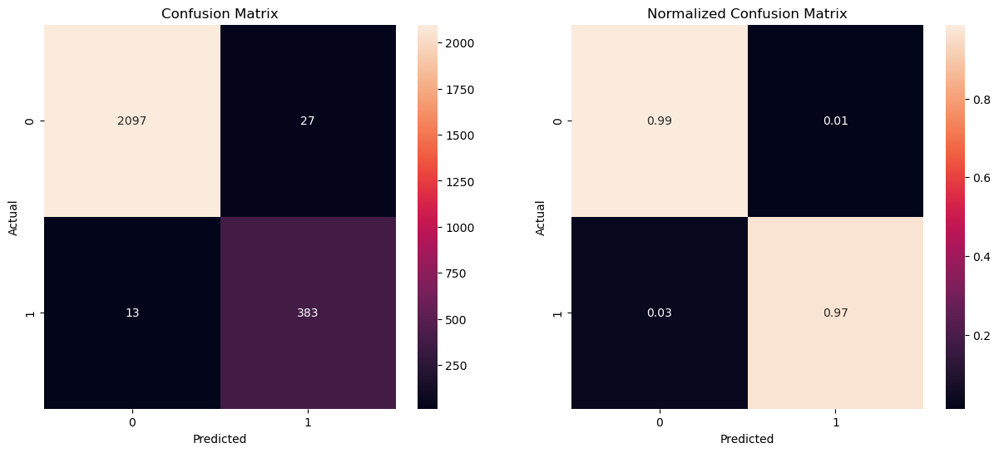

In [11]:
predictions = automl.predict(X_train)
display_metrics(y_train, predictions)

### Testing and evaluation

Accuracy score: 0.9571
Precision score: 0.9151
Recall score: 0.9253
F1 score: 0.9201
ROC auc score: 0.9253
Log loss: 1.5447





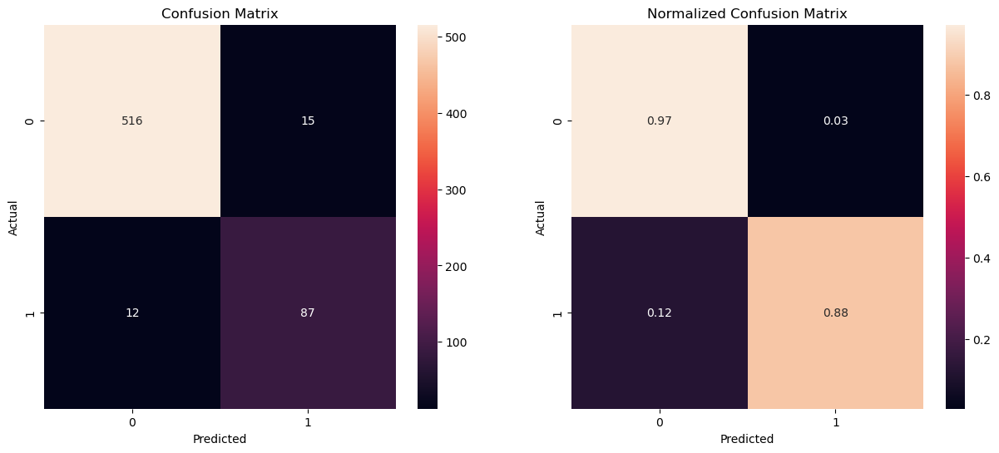

In [12]:
X_test = test_df.drop(columns=[label])
y_test = test_df[label]

y_pred = automl.predict(X_test)
display_metrics(y_test, y_pred)

### MLJar Report

In [13]:
automl.report()

Best model,name,model_type,metric_type,metric_value,train_time,single_prediction_time
,1_Linear,Linear,f1,0.568659,7.37,0.0451
,2_Default_LightGBM,LightGBM,f1,0.866142,5.06,0.0227
,3_Default_Xgboost,Xgboost,f1,0.863049,4.86,0.0266
,4_Default_CatBoost,CatBoost,f1,0.881137,4.01,0.0155
,5_Default_NeuralNetwork,Neural Network,f1,0.842371,4.53,0.0448
,6_Default_RandomForest,Random Forest,f1,0.753388,4.39,0.1006
,11_LightGBM,LightGBM,f1,0.88,6.59,0.0253
,7_Xgboost,Xgboost,f1,0.847368,5.29,0.0248
,15_CatBoost,CatBoost,f1,0.875,5.09,0.0153
,19_RandomForest,Random Forest,f1,0.744444,4.59,0.0985
